**Inaccess Assignment**

*Case Study for the Machine Learning Engineer position*

Importing libraries

In [173]:
import pandas as pd
import numpy as np
from pandas import datetime
from statsmodels.graphics.tsaplots import plot_acf
import sklearn
from sklearn import preprocessing, linear_model
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import seaborn as sns


In [295]:
df = pd.read_csv("dataset_v1.csv", header=0)
df.shape
df.head()

,timestamp,AverageModuleTemperatureCleansed,AverageIrradianceCleansed,AverageAmbientAirTemperature,ActivePowerToUtility,NominalOutputPower,solar elevation,solar azimuth
0,2018-01-01 00:30:00+00:00,2.021694,0.0,6.286658,0.0,4996.98,-59.900514,6.607288
1,2018-01-01 00:45:00+00:00,2.038034,0.0,6.281669,0.0,4996.98,-59.506612,13.403474
2,2018-01-01 01:00:00+00:00,2.359835,0.0,6.306547,0.0,4996.98,-58.855841,20.018743
3,2018-01-01 01:15:00+00:00,1.525561,0.0,5.758329,0.0,4996.98,-57.964935,26.383589
4,2018-01-01 01:30:00+00:00,1.274967,0.0,5.743326,0.0,4996.98,-56.854742,32.450180


In [175]:
df.dtypes

timestamp                            object
AverageModuleTemperatureCleansed    float64
AverageIrradianceCleansed           float64
AverageAmbientAirTemperature        float64
ActivePowerToUtility                float64
NominalOutputPower                  float64
solar elevation                     float64
solar azimuth                       float64
dtype: object

In [176]:
df.isnull().sum()

timestamp                           0
AverageModuleTemperatureCleansed    0
AverageIrradianceCleansed           0
AverageAmbientAirTemperature        0
ActivePowerToUtility                0
NominalOutputPower                  0
solar elevation                     0
solar azimuth                       0
dtype: int64

**Time series testing**

In [213]:
series = df[['timestamp','ActivePowerToUtility']]
#series.head()

In [214]:
series['timestamp'] = series['timestamp'].astype('datetime64[ns]')
series = series.set_index('timestamp')
series_mean = series.resample('H').mean()
series.head()

,ActivePowerToUtility
timestamp,
2018-01-01 00:30:00,0.0
2018-01-01 00:45:00,0.0
2018-01-01 01:00:00,0.0
2018-01-01 01:15:00,0.0
2018-01-01 01:30:00,0.0


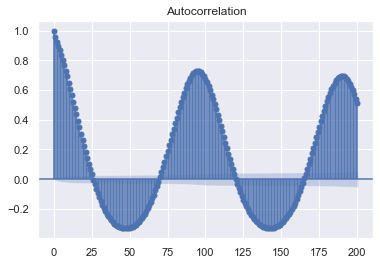

In [215]:
plot_acf(series['ActivePowerToUtility'], lags=200)
plt.show()

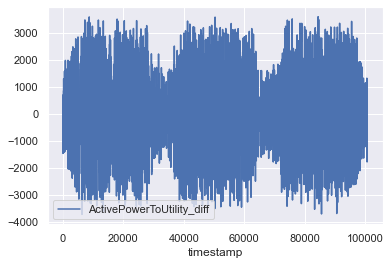

In [224]:
def difference(dataset, interval):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return pd.DataFrame(diff, columns = ["ActivePowerToUtility_diff"])
series_diff = difference(series['ActivePowerToUtility'], 90)
series_diff['timestamp'] = range(0,len(series_diff['ActivePowerToUtility_diff']))
series_diff.plot(kind='line',x='timestamp',y='ActivePowerToUtility_diff')
plt.show()

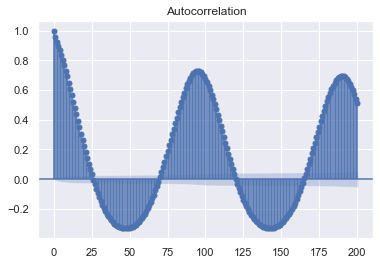

In [164]:
plot_acf(series['ActivePowerToUtility'], lags=200)
plt.show()

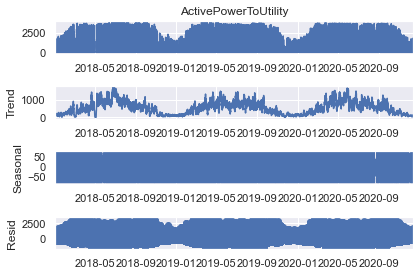

In [166]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot
result = seasonal_decompose(series['ActivePowerToUtility'], model='additive', freq=250)
result.plot()
pyplot.show()

**Exploring linear correlation between features**

In [296]:
df = df.drop(['timestamp'], axis=1)
df_names = df.columns

scaled_df = scaler.fit_transform(df)
scaled_df = pd.DataFrame(scaled_df, columns=df_names)

In [297]:

Act_pwr_tu   = df['ActivePowerToUtility']
Avg_Irr_Cl   = df['AverageIrradianceCleansed']
Avg_Mod_Temp = df['AverageModuleTemperatureCleansed']
Avg_Amb_Temp = df['AverageAmbientAirTemperature']
Nom_Out_pwr  = df['NominalOutputPower']
Sol_Elev     = df['solar elevation']
SOl_Az       = df['solar azimuth']

# Pearson's r correlation coefficient 
# r~1 value implies very strong positive linear relationship
# r~0 implies independency

print("Pearson's r correlation coefficient:\n", 
Avg_Irr_Cl.corr(Act_pwr_tu),"\n",
Avg_Mod_Temp.corr(Act_pwr_tu),"\n",
Avg_Amb_Temp.corr(Act_pwr_tu),"\n", 
Nom_Out_pwr.corr(Act_pwr_tu),"\n", 
Sol_Elev.corr(Act_pwr_tu),"\n", 
SOl_Az.corr(Act_pwr_tu))
# Avg_Irr_Cl.corr(Act_pwr_tu, method='spearman') # 0.9830724763141077
# Avg_Irr_Cl.corr(Act_pwr_tu, method='kendall')  # 0.9616852480880433




Pearson's r correlation coefficient:
 0.9780404330018979 
 0.8188464431234479 
 0.4695007369776339 
 -2.3376643433676944e-16 
 0.6880647678248205 
 0.08820305047119306


**Linear Regression**

In [298]:
dfnp = np.array(df[['AverageIrradianceCleansed', 'ActivePowerToUtility']])

X = dfnp[:,0]
y = dfnp[:,1]
print('AverageIrradianceCleansed: mean=%.3f stdv=%.3f' % (np.mean(X), np.std(X)))
print('ActivePowerToUtility: mean=%.3f stdv=%.3f' % (np.mean(y), np.std(y)))

AverageIrradianceCleansed: mean=133.766 stdv=228.587
ActivePowerToUtility: mean=559.120 stdv=944.331


In [314]:
X = dfnp[:,0].reshape(-1,1)
y = dfnp[:,1].reshape(-1,1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(75543, 1) (75543, 1)
(25182, 1) (25182, 1)


In [315]:
# fit the model
lm = linear_model.LinearRegression()
model = lm.fit(X_train, y_train)
predictions = lm.predict(X_test)
predictions.shape

(25182, 1)

In [316]:
formatted_float = "{:.4f}".format(model.score(X_test, y_test))
print ("Score: ",  formatted_float)

Score:  0.9583


<AxesSubplot:>

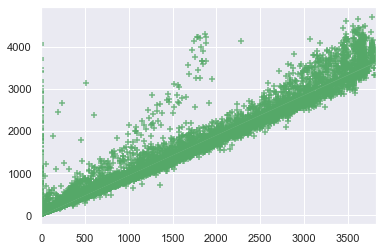

In [317]:
sns.set_theme(color_codes=True)
sns.regplot(y_test, predictions, color='g', marker = "+")

**Multiple Linear Regression Model - Testing accuracy**

In [272]:
X_mul = df[['AverageModuleTemperatureCleansed', 'AverageIrradianceCleansed', 'solar elevation']]
# Keeping the three strongest predictors based on Pearson's r coefficient values

y_mul = df[['ActivePowerToUtility']]

In [273]:
x_names = X_mul.columns
y_names = y_mul.columns

scaler = preprocessing.StandardScaler()

scaled_X = scaler.fit_transform(X_mul)
scaled_X = pd.DataFrame(scaled_X, columns=x_names)

scaled_y = scaler.fit_transform(y_mul)
scaled_y = pd.DataFrame(scaled_y, columns=y_names)

In [274]:
Xm_train, Xm_test, ym_train, ym_test = train_test_split(scaled_X, scaled_y, test_size=0.5)

regr = linear_model.LinearRegression();
regr.fit(Xm_train, ym_train);

In [275]:
predictions_m = regr.predict(Xm_test)
predictions_m.shape

(50363, 1)

In [276]:
formatted_float2 = "{:.4f}".format(regr.score(Xm_test, ym_test))
print ("Score: ",  formatted_float2)

Score:  0.9599


<AxesSubplot:xlabel='ActivePowerToUtility'>

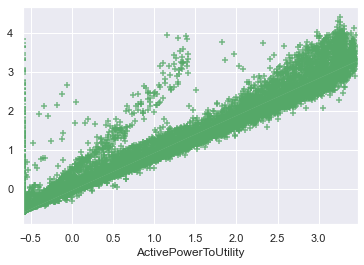

In [277]:
sns.regplot(ym_test, predictions_m, color='g', marker = "+")